### Magics

In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

### Imports

In [2]:
import os
import sys

import numpy as np
import cv2
import matplotlib.pyplot as plt

from pathlib import Path
import glob
import logging, sys

### Settings

In [4]:
# get project path, and flag if script runs in a file
project_path = Path(os.getcwd(), os.pardir)
output_path = project_path / "output"

# add project root to pythonpath
sys.path.insert(0, str(project_path / "src"))

# import custom packages
from src.set_cardgame.identify import identify_images
from src.set_cardgame.utils import setup_logger, to_rgb3, read_image_with_cards, plot_images

logger = setup_logger(level=logging.INFO)
logging.disable(sys.maxsize)

### Identify images

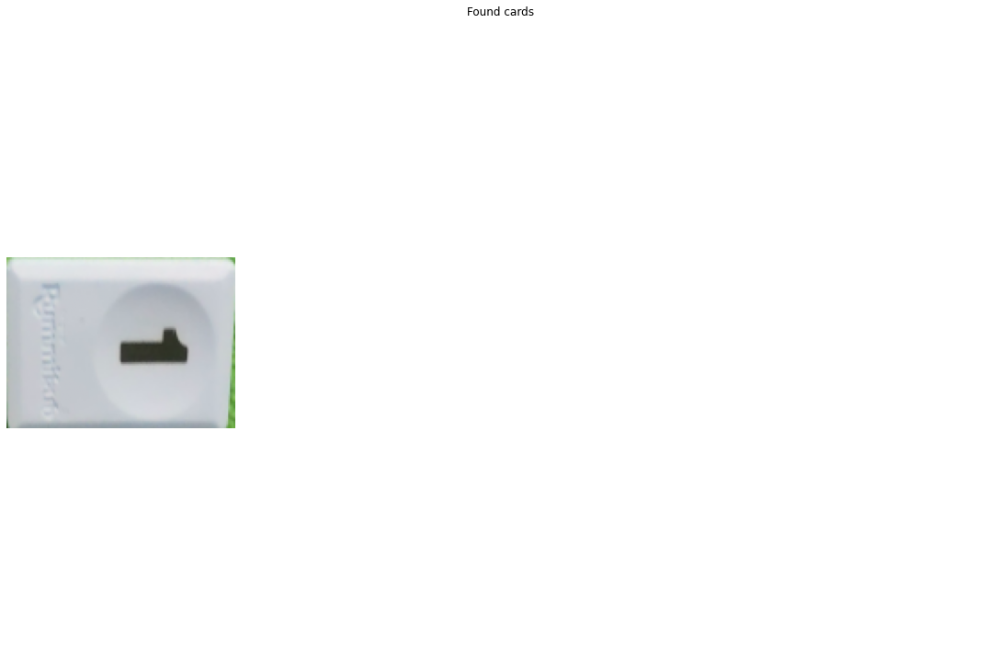

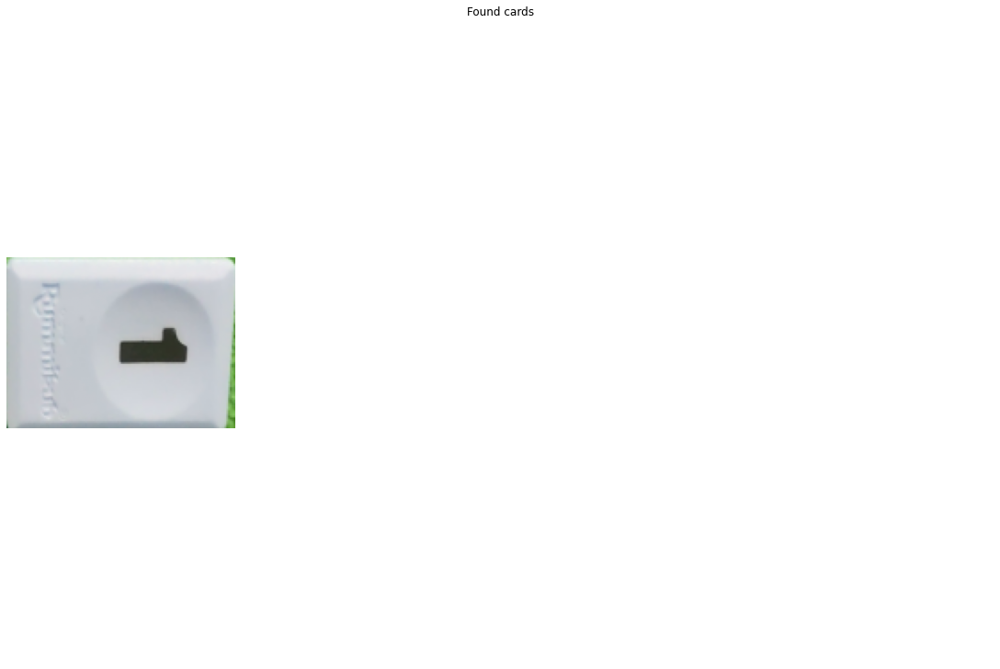

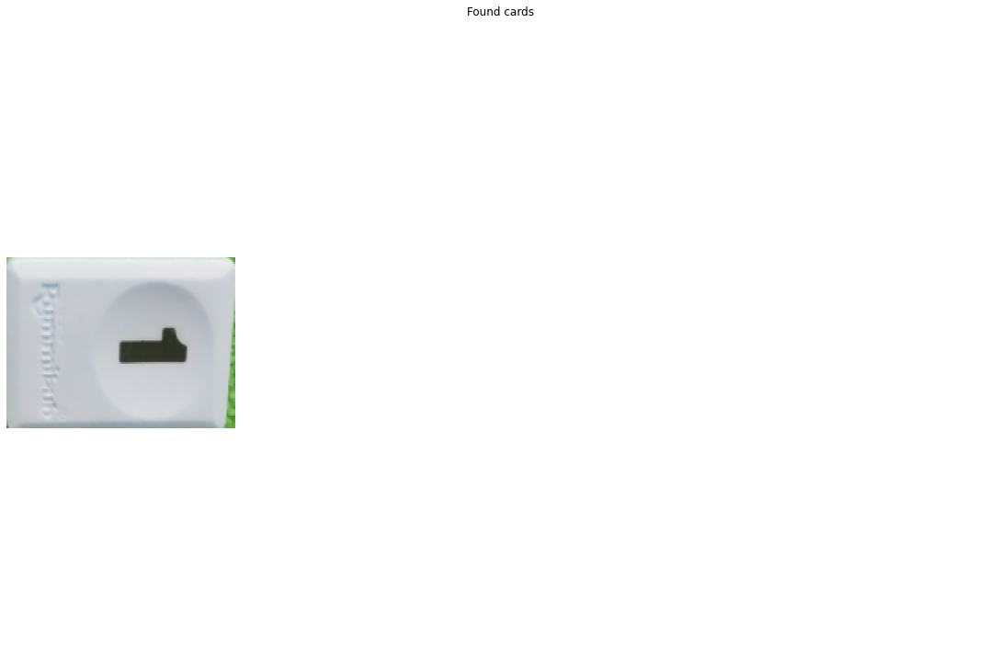

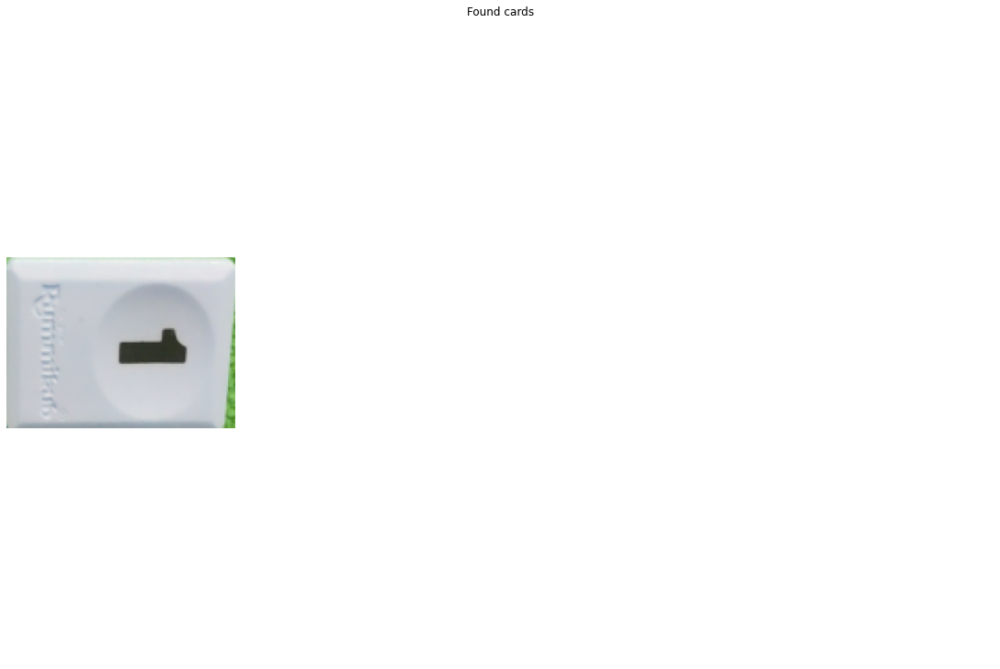

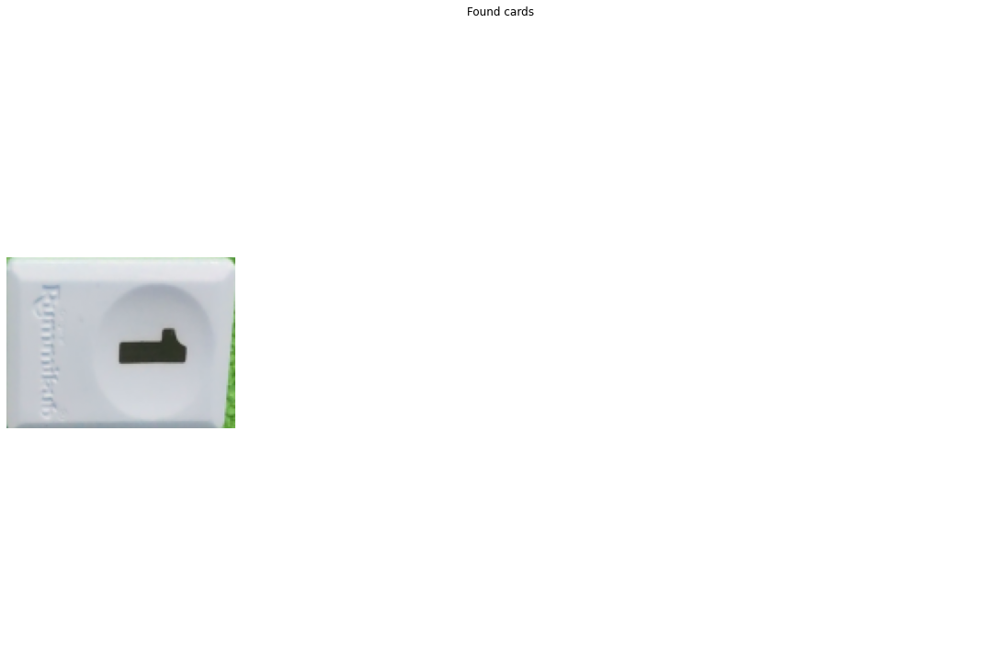

...

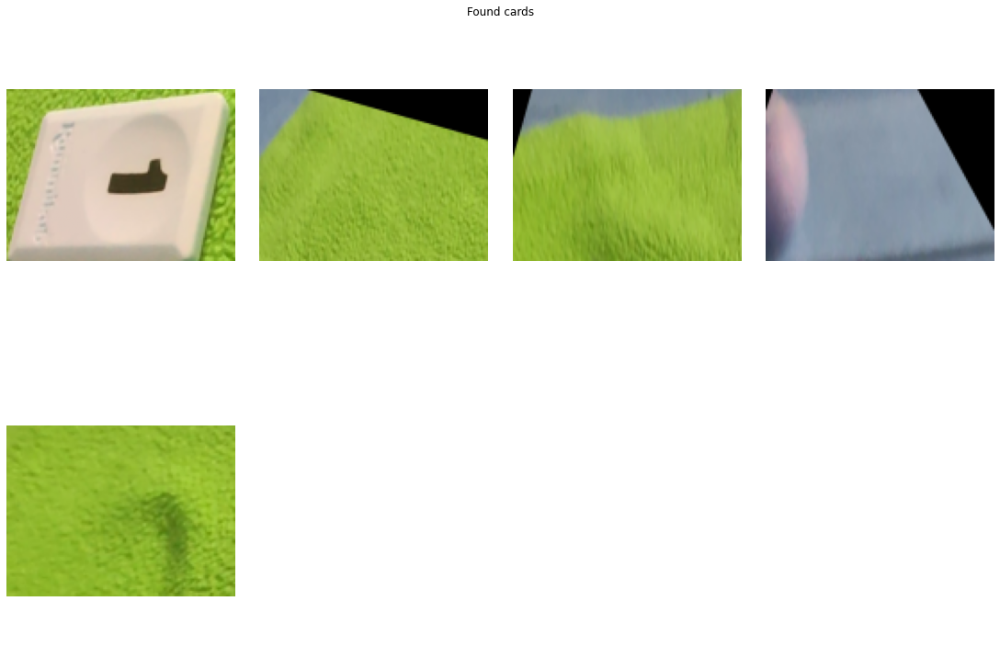

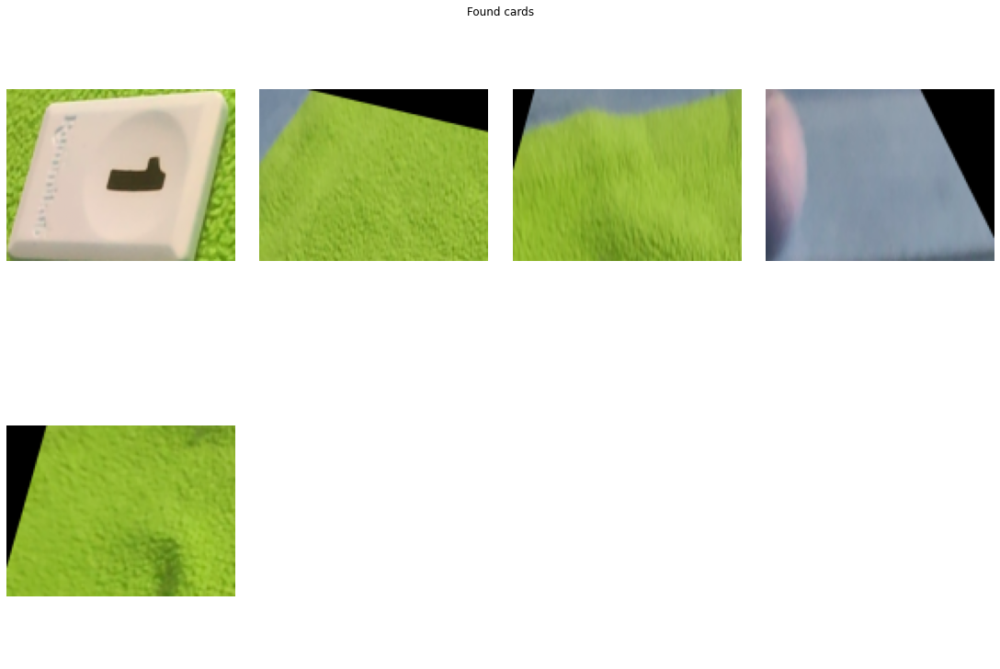

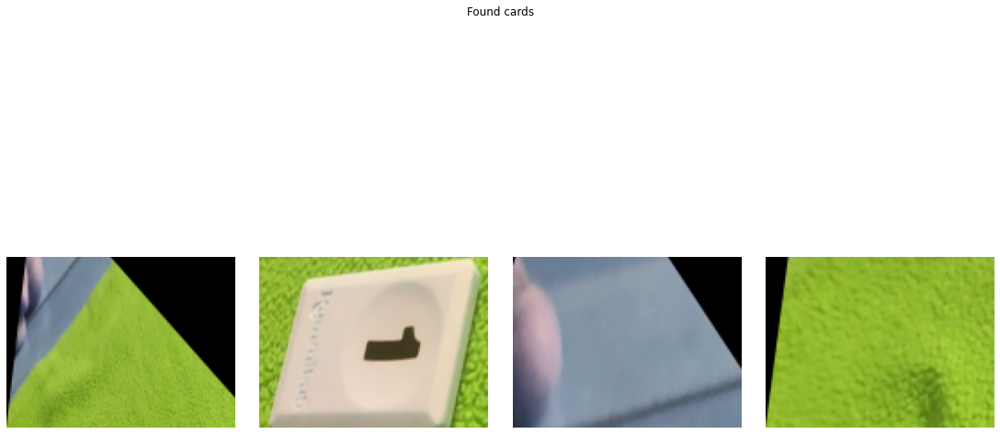

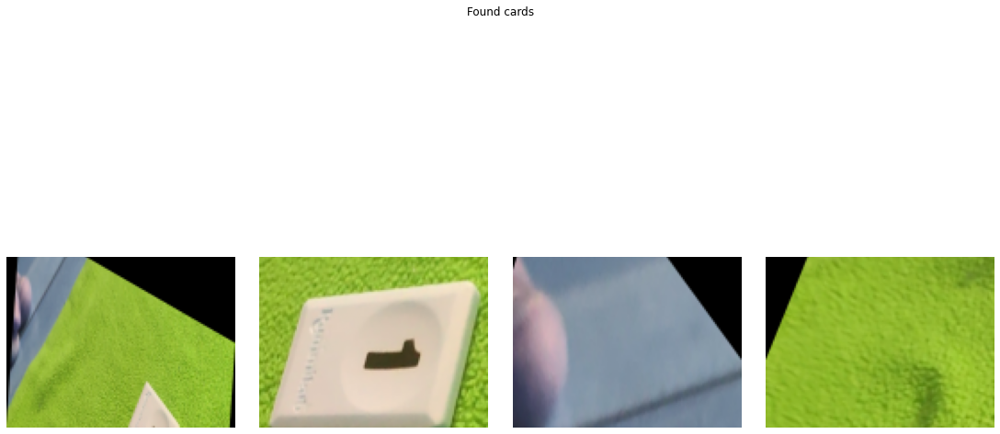

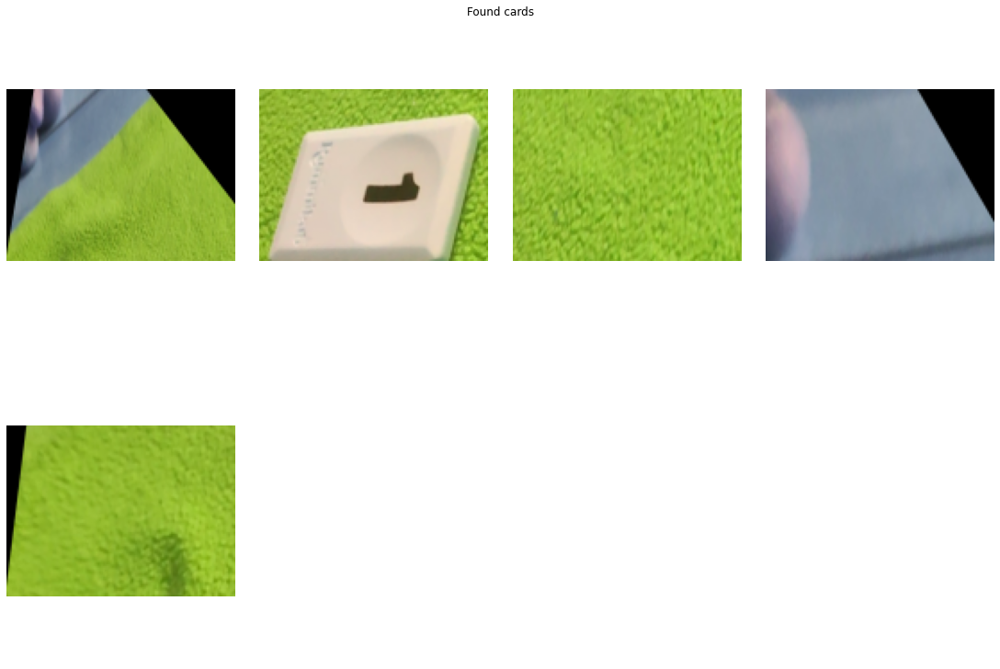

KeyboardInterrupt: 

In [7]:
# path to test images
# test_images_path = "../../images/test/test/images"
test_images_path = "../../images/raw/mp4/1-black.mp4"

cap = cv2.VideoCapture(test_images_path)
success, img1 = cap.read()
while success:
# for image_path in glob.glob(test_images_path + "/*.jpg"):
    # img1 = read_image_with_cards(image_path, convert_to_rgb=True)

    # identify the different cards from the image, returns bounding boxes and intermediate steps for plotting
    identified_cards, bboxes, rejected_bboxes, intermediate_steps = identify_images(img1, target_size=(128, 96))

    # plot found and rejected contours
    img_contours = cv2.drawContours(to_rgb3(intermediate_steps[-1]), bboxes, -1, (255, 22, 84), 12)
    img_contours_rejected = cv2.drawContours(to_rgb3(intermediate_steps[-1]), rejected_bboxes, -1, (84, 22, 255), 12)

    # prepare list of images for pre-processing subplot
    images_to_plot = [img1] + intermediate_steps + [img_contours, img_contours_rejected]

    # cv2.imwrite(
    #     f"{output_path}/{image_path.split('/')[-1]}",
    #     np.concatenate((img1, img_contours), axis=1)[:,:,[2, 1, 0]]
    # )

    # plt.imshow(np.concatenate((img1, img_contours), axis=1))
    # plt.axis("off")
    # plt.show()

    # plot all intermediate pre-processing steps
    # fig = plot_images(images_to_plot, suptitle="", titles=["original", "increase contrast", "grayscale", "blurred", "threshold", "erode", f"found contours: {len(bboxes)}", f"rejected contours: {len(rejected_bboxes)}"], ncols=4, figsize=(20, 10))

    if len(identified_cards) > 0:
        # plot found cards
        fig = plot_images(identified_cards, suptitle=f"Found cards", titles=[], ncols=3, figsize=(5, 3))
    plt.show()

    success, img1 = cap.read()
    # break
